nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 6.

## Scenario 1. RNN Cells
 * RNN's Problem
   - Long-Term Dependency 
   
  

 * Building Model  
   - LSTM Cell
   - GRU Cell
   - Dynamic RNN
   - Bidirectional RNN

### RNN's Problem 

#### Long-Term Dependency
 - 현재 state와 과거 input과의 term이 길 때 input을 반영하지 못하는 현상(너무 길게 외우면 까먹는 현상)

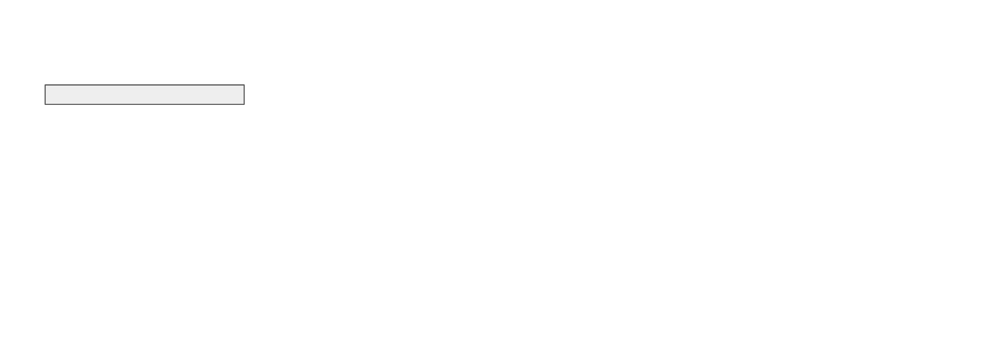

In [2]:
Image('./day6/long_term_dependency.gif.png')

### Buiding Model LSTM
 - LSTM은 RNN의 장기종속성 문제 (Long-Term Dependency)를 해결하여 메모리 용량을 대폭 상승 시킴
 - 일반적으로 RNN Cell을 구성할 때 가장 첫 번째로 적용 해 볼 수 있는 강력한 Cell
 - RNN과는 다르게 input 정보를 효율적으로, 균일하게 저장

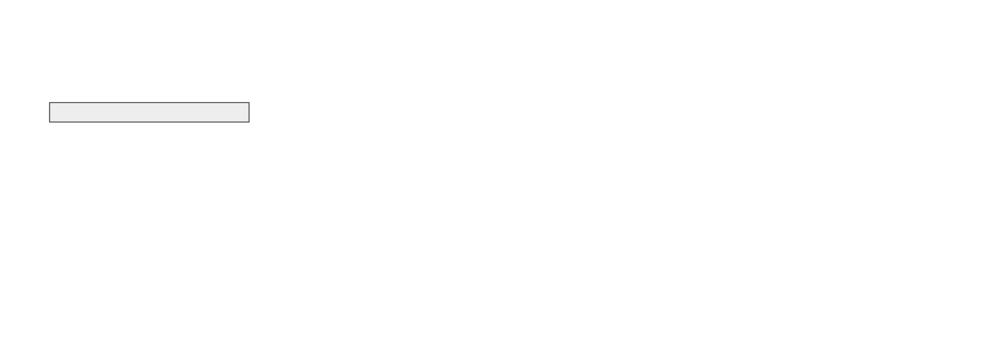

In [3]:
Image('./day6/lstm.gif.png')

#### LSTM Structure

 - LSTM에서는 Cell state와 hidden layer가 별도로 존재
 - Cell state가 주로 정보 기억을 담당
 - forget gate에서는 Cell상에서 크게 중요하지 않은 정보를 삭제
 - hidden layer(tanh)는 sigmoid gate(input gate)를 통해 중요한 정보만을 Cell에 update
 - Cell state는 forget gate, input gate를 거친 후 다음 상태로 넘어감
 - hidden layer는 다음 Cell에서 다음 step의 input과 concatnate하여 Cell 입력

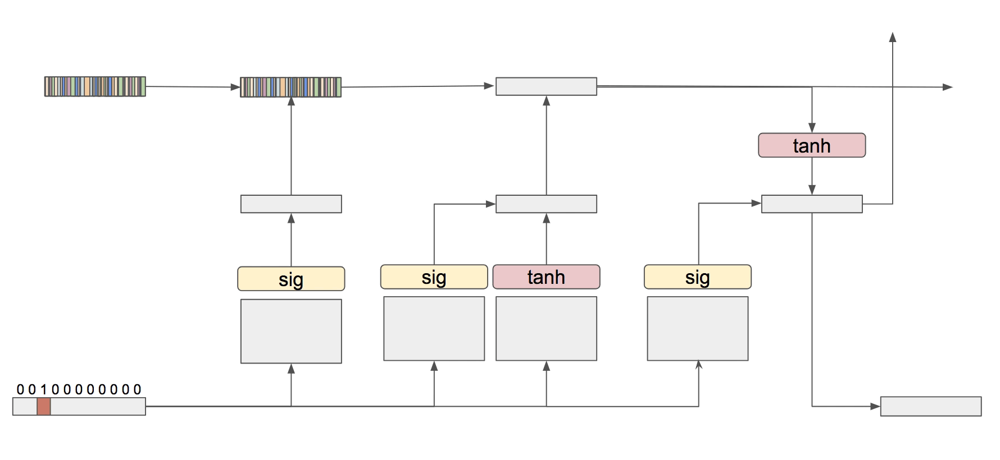

In [11]:
Image('./day6/lstm.gif.png')

#### GRU Structure

 - input gate를 1 - forget_gate로 처리함으로써 weight를 줄임
 - input gate와 forget gate를 반대로 동작하도록 만든 것이 특징
 - 실제로 LSTM과 유사한 성능을 가지며 연산량 감소

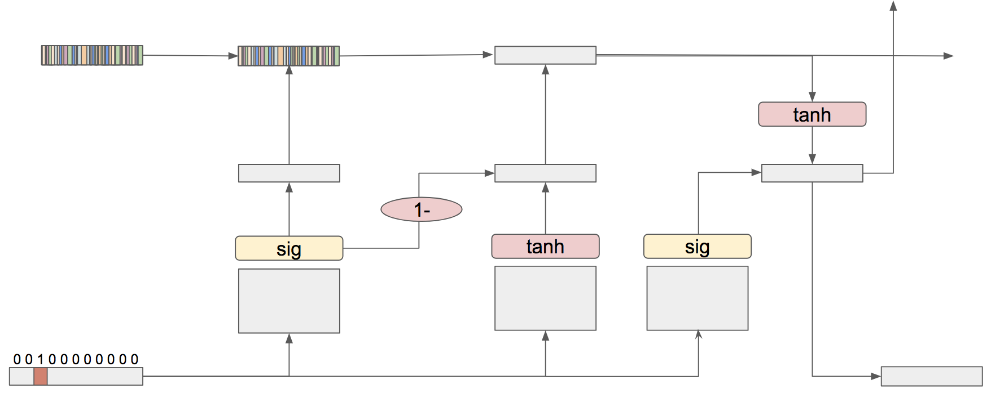

In [10]:
Image('./day6/gru.gif.png')

#### Dynamic RNN
 - static rnn 보다 사실상 더 많이 사용하는 구조
 - padding에 대하여 loss를 구하지 않으므로 가변 길이 데이터에 대해 원활한 학습 가능

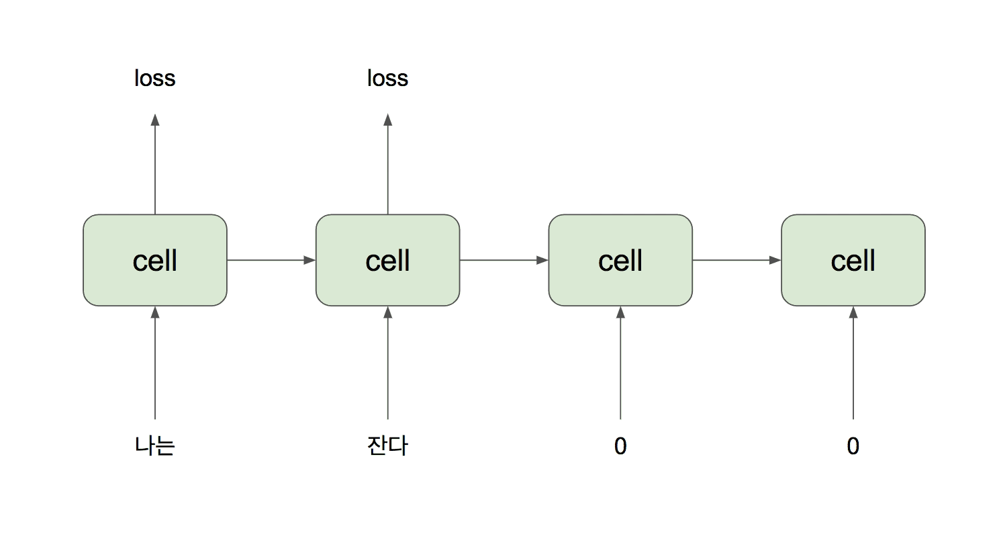

In [12]:
Image('./day6/dynamic_rnn.gif.png')

#### Bidirectional RNN

 - RNN Cell을 두개씩 갖고 있어서 서로 반대 방향의 time step별 state를 가지는 RNN 구조
 - 번역의 경우 문법이 다른 두 언어를 학습 시킬 때 용이

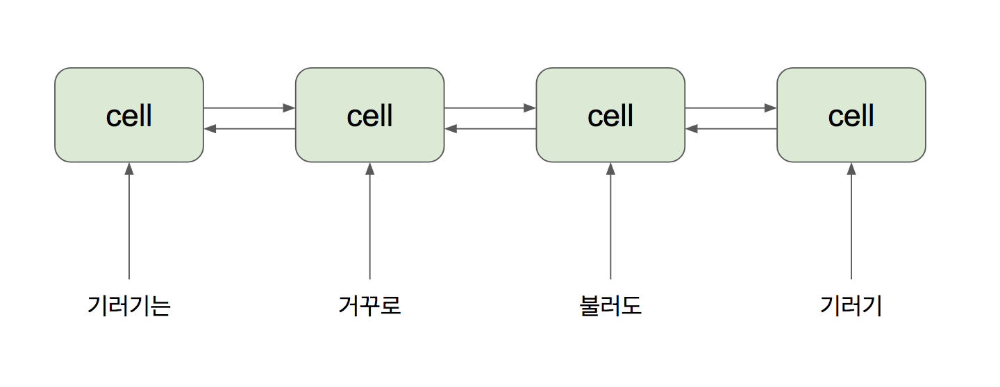

In [14]:
Image('./day6/bidirectional_rnn.png')

### Practice LSTM & GRU

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
tf.reset_default_graph()

t = np.array([float(i)*0.01 for i in range(10000+1)])
sin = np.sin(t[:-1])
sin_next = np.sin(t[1:])

print_summaries = 3
print(sin[:print_summaries], sin[-print_summaries:])
print(sin_next[:print_summaries], sin_next[-print_summaries:])


time_step = 100
reshaped_sin = np.reshape(sin, [-1, time_step, 1])
reshaped_sin_next = np.reshape(sin_next, [-1, 1])

signal = tf.placeholder(tf.float32, [None, time_step, 1])
signal_next = tf.placeholder(tf.float32, [None, 1])

inputs = tf.unstack(signal, axis=1)
for i, _input in enumerate(inputs):
    print('unstacked input {} shape {}'.format(i, _input.shape))

state_size = 10
rnn_cell = tf.nn.rnn_cell.LSTMCell(state_size)
#rnn_cell = tf.nn.rnn_cell.GRUCell(state_size)
outputs, state = tf.nn.static_rnn(rnn_cell, inputs, dtype=tf.float32)

for i, _output in enumerate(outputs):
    print('rnn output {} shape {}'.format(i, _output.shape))

reshaped_outputs = tf.reshape(tf.stack(outputs, axis=1), [-1, state_size])

print('stacked and reshaped rnn output {}'.format(reshaped_outputs.shape))

out = tf.layers.dense(reshaped_outputs, 1, use_bias=False)

print('output {}'.format(out.shape))

loss = tf.losses.mean_squared_error(signal_next, out)
train_op = tf.train.GradientDescentOptimizer(1e-2).minimize(loss)

[ 0.          0.00999983  0.01999867] [-0.53200348 -0.5235096  -0.51496337]
[ 0.00999983  0.01999867  0.0299955 ] [-0.5235096  -0.51496337 -0.50636564]
unstacked input 0 shape (?, 1)
unstacked input 1 shape (?, 1)
unstacked input 2 shape (?, 1)
unstacked input 3 shape (?, 1)
unstacked input 4 shape (?, 1)
unstacked input 5 shape (?, 1)
unstacked input 6 shape (?, 1)
unstacked input 7 shape (?, 1)
unstacked input 8 shape (?, 1)
unstacked input 9 shape (?, 1)
unstacked input 10 shape (?, 1)
unstacked input 11 shape (?, 1)
unstacked input 12 shape (?, 1)
unstacked input 13 shape (?, 1)
unstacked input 14 shape (?, 1)
unstacked input 15 shape (?, 1)
unstacked input 16 shape (?, 1)
unstacked input 17 shape (?, 1)
unstacked input 18 shape (?, 1)
unstacked input 19 shape (?, 1)
unstacked input 20 shape (?, 1)
unstacked input 21 shape (?, 1)
unstacked input 22 shape (?, 1)
unstacked input 23 shape (?, 1)
unstacked input 24 shape (?, 1)
unstacked input 25 shape (?, 1)
unstacked input 26 shape (

step: 0, loss: 0.5407164692878723
step: 100, loss: 0.09958840161561966
step: 200, loss: 0.014280123636126518
step: 300, loss: 0.011075153015553951
step: 400, loss: 0.010482614859938622
step: 500, loss: 0.010000787675380707
step: 600, loss: 0.009578365832567215
step: 700, loss: 0.009203790687024593
step: 800, loss: 0.008868612349033356
step: 900, loss: 0.008566288277506828


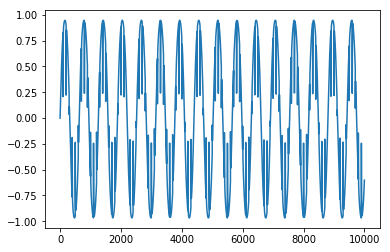

In [3]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for i in range(1000):
        _, _loss = sess.run([train_op, loss], feed_dict={signal: reshaped_sin, signal_next: reshaped_sin_next})
        if i%100 == 0:
            print('step: {}, loss: {}'.format(i, _loss))
        
    _pred = sess.run(out, feed_dict={signal: reshaped_sin})
    _reshaped_pred = np.reshape(_pred, [-1])
    plt.plot(_reshaped_pred)
    plt.show()

### Scenario 2. Advenced RNNs
 * Building Model

### Building Model
 - dynamic rnn
 - bidirectional rnn

### Practice (dynamic rnn)

In [7]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [8]:
tf.reset_default_graph()

t = np.array([float(i)*0.01 for i in range(10000+1)])
sin = np.sin(t[:-1])
sin_next = np.sin(t[1:])

print_summaries = 3
print(sin[:print_summaries], sin[-print_summaries:])
print(sin_next[:print_summaries], sin_next[-print_summaries:])


time_step = 5
reshaped_sin = np.reshape(sin, [-1, time_step, 1])
reshaped_sin_next = np.reshape(sin_next, [-1, 1])

signal = tf.placeholder(tf.float32, [None, time_step, 1])
signal_next = tf.placeholder(tf.float32, [None, 1])

rnn_cell = tf.nn.rnn_cell.LSTMCell(10)
outputs, state = tf.nn.dynamic_rnn(rnn_cell, signal, dtype=tf.float32)

reshaped_outputs = tf.reshape(outputs, [-1, 10])
out = tf.layers.dense(reshaped_outputs, 1)

loss = tf.losses.mean_squared_error(signal_next, out)
train_op = tf.train.GradientDescentOptimizer(1e-4).minimize(loss)

[ 0.          0.00999983  0.01999867] [-0.53200348 -0.5235096  -0.51496337]
[ 0.00999983  0.01999867  0.0299955 ] [-0.5235096  -0.51496337 -0.50636564]


step: 0, loss: 0.5491990447044373
step: 1, loss: 0.5491414070129395
step: 2, loss: 0.5490840077400208
step: 3, loss: 0.5490259528160095
step: 4, loss: 0.5489682555198669
step: 5, loss: 0.5489102602005005
step: 6, loss: 0.5488526225090027
step: 7, loss: 0.5487950444221497
step: 8, loss: 0.5487377643585205
step: 9, loss: 0.548679769039154
step: 10, loss: 0.548622190952301
step: 11, loss: 0.5485646724700928
step: 12, loss: 0.5485064387321472
step: 13, loss: 0.548448920249939
step: 14, loss: 0.5483918190002441
step: 15, loss: 0.5483338832855225
step: 16, loss: 0.5482762455940247
step: 17, loss: 0.5482186675071716
step: 18, loss: 0.5481612086296082
step: 19, loss: 0.5481035709381104
step: 20, loss: 0.5480460524559021
step: 21, loss: 0.5479885935783386
step: 22, loss: 0.547930896282196
step: 23, loss: 0.5478731393814087
step: 24, loss: 0.5478159785270691
step: 25, loss: 0.5477585196495056
step: 26, loss: 0.5477007627487183
step: 27, loss: 0.5476434826850891
step: 28, loss: 0.5475857257843018

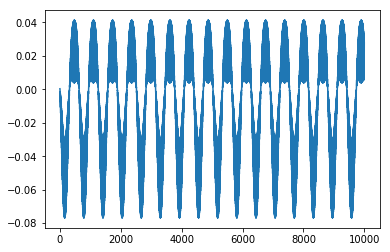

In [9]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for i in range(100):
        _, _loss = sess.run([train_op, loss], feed_dict={signal: reshaped_sin, signal_next: reshaped_sin_next})
        print('step: {}, loss: {}'.format(i, _loss))
        
    _pred = sess.run(out, feed_dict={signal: reshaped_sin})
    _reshaped_pred = np.reshape(_pred, [-1])
    plt.plot(_reshaped_pred)
    plt.show()
        

### Practice (dynamic rnn)

In [10]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [12]:
tf.reset_default_graph()

t = np.array([float(i)*0.01 for i in range(10000+1)])
sin = np.sin(t[:-1])
sin_next = np.sin(t[1:])

print_summaries = 3
print(sin[:print_summaries], sin[-print_summaries:])
print(sin_next[:print_summaries], sin_next[-print_summaries:])


time_step = 5
reshaped_sin = np.reshape(sin, [-1, time_step, 1])
reshaped_sin_next = np.reshape(sin_next, [-1, 1])

signal = tf.placeholder(tf.float32, [None, time_step, 1])
signal_next = tf.placeholder(tf.float32, [None, 1])

rnn_cell = tf.nn.rnn_cell.LSTMCell(10)
outputs, state = tf.nn.dynamic_rnn(rnn_cell, signal, dtype=tf.float32)

reshaped_outputs = tf.reshape(outputs, [-1, 10])
out = tf.layers.dense(reshaped_outputs, 1)

loss = tf.losses.mean_squared_error(signal_next, out)
train_op = tf.train.GradientDescentOptimizer(1e-4).minimize(loss)

[ 0.          0.00999983  0.01999867] [-0.53200348 -0.5235096  -0.51496337]
[ 0.00999983  0.01999867  0.0299955 ] [-0.5235096  -0.51496337 -0.50636564]


step: 0, loss: 0.4083678126335144
step: 1, loss: 0.4083132743835449
step: 2, loss: 0.4082582890987396
step: 3, loss: 0.40820351243019104
step: 4, loss: 0.4081488251686096
step: 5, loss: 0.4080940783023834
step: 6, loss: 0.4080393612384796
step: 7, loss: 0.40798458456993103
step: 8, loss: 0.4079299867153168
step: 9, loss: 0.4078752398490906
step: 10, loss: 0.40782031416893005
step: 11, loss: 0.4077657461166382
step: 12, loss: 0.4077109396457672
step: 13, loss: 0.4076560437679291
step: 14, loss: 0.4076012670993805
step: 15, loss: 0.40754660964012146
step: 16, loss: 0.40749216079711914
step: 17, loss: 0.40743735432624817
step: 18, loss: 0.40738266706466675
step: 19, loss: 0.4073279798030853
step: 20, loss: 0.40727362036705017
step: 21, loss: 0.4072188436985016
step: 22, loss: 0.4071643650531769
step: 23, loss: 0.40710973739624023
step: 24, loss: 0.4070550203323364
step: 25, loss: 0.407000333070755
step: 26, loss: 0.40694600343704224
step: 27, loss: 0.4068913459777832
step: 28, loss: 0.406

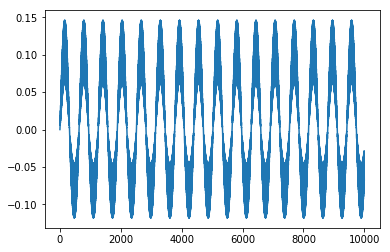

In [13]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for i in range(100):
        _, _loss = sess.run([train_op, loss], feed_dict={signal: reshaped_sin, signal_next: reshaped_sin_next})
        print('step: {}, loss: {}'.format(i, _loss))
        
    _pred = sess.run(out, feed_dict={signal: reshaped_sin})
    _reshaped_pred = np.reshape(_pred, [-1])
    plt.plot(_reshaped_pred)
    plt.show()
        

### Practice (bidirectional rnn)

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
tf.reset_default_graph()

t = np.array([float(i)*0.01 for i in range(10000+1)])
sin = np.sin(t[:-1])
sin_next = np.sin(t[1:])

print_summaries = 3
print(sin[:print_summaries], sin[-print_summaries:])
print(sin_next[:print_summaries], sin_next[-print_summaries:])


time_step = 5
reshaped_sin = np.reshape(sin, [-1, time_step, 1])
reshaped_sin_next = np.reshape(sin_next, [-1, 1])

signal = tf.placeholder(tf.float32, [None, time_step, 1])
signal_next = tf.placeholder(tf.float32, [None, 1])

state_size = 10
lstm_cell_f = tf.nn.rnn_cell.LSTMCell(state_size)
lstm_cell_b = tf.nn.rnn_cell.LSTMCell(state_size)
(output_f, output_b), (state_f, state_b) = tf.nn.bidirectional_dynamic_rnn(
    lstm_cell_f, lstm_cell_b, signal, dtype=tf.float32)


outputs = tf.concat([output_f, output_b], axis=2)
print(outputs.shape)
reshaped_outputs = tf.reshape(outputs, [-1, 2*state_size])
out = tf.layers.dense(reshaped_outputs, 1)

loss = tf.losses.mean_squared_error(signal_next, out)
train_op = tf.train.GradientDescentOptimizer(1e-4).minimize(loss)

[ 0.          0.00999983  0.01999867] [-0.53200348 -0.5235096  -0.51496337]
[ 0.00999983  0.01999867  0.0299955 ] [-0.5235096  -0.51496337 -0.50636564]
(?, 5, 20)


step: 0, loss: 0.4083678126335144
step: 1, loss: 0.4083132743835449
step: 2, loss: 0.4082582890987396
step: 3, loss: 0.40820351243019104
step: 4, loss: 0.4081488251686096
step: 5, loss: 0.4080940783023834
step: 6, loss: 0.4080393612384796
step: 7, loss: 0.40798458456993103
step: 8, loss: 0.4079299867153168
step: 9, loss: 0.4078752398490906
step: 10, loss: 0.40782031416893005
step: 11, loss: 0.4077657461166382
step: 12, loss: 0.4077109396457672
step: 13, loss: 0.4076560437679291
step: 14, loss: 0.4076012670993805
step: 15, loss: 0.40754660964012146
step: 16, loss: 0.40749216079711914
step: 17, loss: 0.40743735432624817
step: 18, loss: 0.40738266706466675
step: 19, loss: 0.4073279798030853
step: 20, loss: 0.40727362036705017
step: 21, loss: 0.4072188436985016
step: 22, loss: 0.4071643650531769
step: 23, loss: 0.40710973739624023
step: 24, loss: 0.4070550203323364
step: 25, loss: 0.407000333070755
step: 26, loss: 0.40694600343704224
step: 27, loss: 0.4068913459777832
step: 28, loss: 0.406

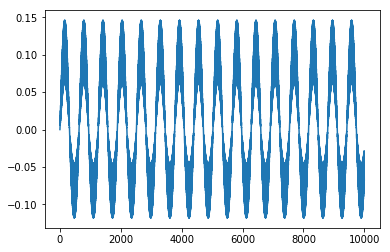

In [13]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for i in range(100):
        _, _loss = sess.run([train_op, loss], feed_dict={signal: reshaped_sin, signal_next: reshaped_sin_next})
        print('step: {}, loss: {}'.format(i, _loss))
        
    _pred = sess.run(out, feed_dict={signal: reshaped_sin})
    _reshaped_pred = np.reshape(_pred, [-1])
    plt.plot(_reshaped_pred)
    plt.show()
        